In [1]:
import re
import string

import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

from wordcloud import WordCloud

import sklearn
from sklearn import preprocessing
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, f1_score,accuracy_score

from sklearn.feature_extraction.text  import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import SGDClassifier
import xgboost as xgb

import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Embedding, GlobalAveragePooling1D
from tensorflow.keras.layers import TextVectorization
from tensorflow.keras import layers, losses


In [2]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
#Penambahan kaggle.json dari user Kaggle agar dapat mengakses API Kaggle
#from google.colab import drive
#drive.mount('/content/drive')

Dataset merupakan dataset yang bertujuan untuk melakukan klasifikasi berita dari corpus AG News.

In [3]:
!pip install kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d amananandrai/ag-news-classification-dataset --unzip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
 44% 5.00M/11.4M [00:00<00:00, 41.6MB/s]
100% 11.4M/11.4M [00:00<00:00, 69.6MB/s]


In [4]:
SEED = 42

TRAIN_DATA_PATH = '/content/train.csv'
TEST_DATA_PATH = '/content/test.csv'

VALIDATION_SPLIT = 0.2  #20% validation split

VOCAB_SIZE = 10000  #besar vocab yang sering dipilih
EMBED_SIZE = 128    
SEQUENCE_LENGTH = 800 #panjang maksimal input agar mencakup mayoritas dataset

BATCH_SIZE = 32
EPOCH = 10

# EDA

In [5]:
raw_train_data = pd.read_csv(TRAIN_DATA_PATH, index_col=False)
test_data = pd.read_csv(TEST_DATA_PATH, index_col=False)

Cek jumlah data pada dataset

In [6]:
raw_train_data.shape, test_data.shape

((120000, 3), (7600, 3))

In [7]:
raw_train_data.isnull().sum()

Class Index    0
Title          0
Description    0
dtype: int64

In [8]:
test_data.isnull().sum()

Class Index    0
Title          0
Description    0
dtype: int64

Didapat tidak ada data null pada dataset. Kemudian mengecek isi dari dataset.

In [9]:
raw_train_data.head()

,Class Index,Title,Description
0,3,Wall St. Bears Claw Back Into the Black (Reuters),"Reuters - Short-sellers, Wall Street's dwindli..."
1,3,Carlyle Looks Toward Commercial Aerospace (Reu...,Reuters - Private investment firm Carlyle Grou...
2,3,Oil and Economy Cloud Stocks' Outlook (Reuters),Reuters - Soaring crude prices plus worries\ab...
3,3,Iraq Halts Oil Exports from Main Southern Pipe...,Reuters - Authorities have halted oil export\f...
4,3,"Oil prices soar to all-time record, posing new...","AFP - Tearaway world oil prices, toppling reco..."


In [10]:
test_data.head()

,Class Index,Title,Description
0,3,Fears for T N pension after talks,Unions representing workers at Turner Newall...
1,4,The Race is On: Second Private Team Sets Launc...,"SPACE.com - TORONTO, Canada -- A second\team o..."
2,4,Ky. Company Wins Grant to Study Peptides (AP),AP - A company founded by a chemistry research...
3,4,Prediction Unit Helps Forecast Wildfires (AP),AP - It's barely dawn when Mike Fitzpatrick st...
4,4,Calif. Aims to Limit Farm-Related Smog (AP),AP - Southern California's smog-fighting agenc...


Cek statistik jumlah kata dari dataset

In [11]:
def text_stats(text_data):
  text_length = []
  for i in text_data:
    text_length.append(len(i))

  text_length_df = pd.DataFrame(text_length)
  return text_length_df

In [12]:
desc_stats = text_stats(raw_train_data['Description'])
desc_stats.describe()

,0
count,120000.000000
mean,193.388517
std,64.472066
min,6.000000
25%,155.000000
50%,188.000000
75%,219.000000
max,985.000000


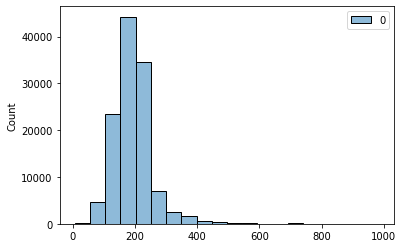

In [13]:
sns.histplot(desc_stats,bins=20)

In [14]:
title_stats = text_stats(raw_train_data['Title'])
title_stats.describe()

,0
count,120000.000000
mean,42.071508
std,13.569405
min,6.000000
25%,33.000000
50%,41.000000
75%,49.000000
max,115.000000


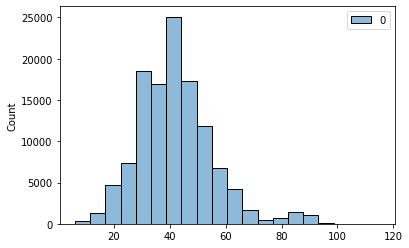

In [15]:
sns.histplot(title_stats,bins=20)

Didapat distribusi panjang kata dari title dan description memiliki tail yang agak panjang. Kolom title dan description juga digabung menjadi satu kolom karena baik judul dan isi artikel dapat menjelaskan topik dari artikel itu sendiri.

In [9]:
X_train = pd.DataFrame()

In [10]:
X_train['Text'] = pd.DataFrame(data=raw_train_data['Title'] + " " + raw_train_data['Description'])

In [11]:
X_train.head()

,Text
0,Wall St. Bears Claw Back Into the Black (Reute...
1,Carlyle Looks Toward Commercial Aerospace (Reu...
2,Oil and Economy Cloud Stocks' Outlook (Reuters...
3,Iraq Halts Oil Exports from Main Southern Pipe...
4,"Oil prices soar to all-time record, posing new..."


In [19]:
train_stats = text_stats(X_train['Text'])
train_stats.describe()

,0
count,120000.000000
mean,236.460025
std,66.529799
min,17.000000
25%,196.000000
50%,232.000000
75%,266.000000
max,1012.000000


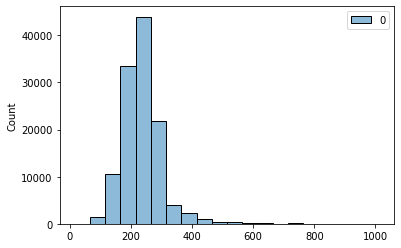

In [20]:
sns.histplot(train_stats,bins=20)

In [12]:
X_test = pd.DataFrame()

In [13]:
X_test['Text'] = test_data['Title'] + " " + test_data['Description']

Didapat distribusi panjang kalimat maksimal yaitu 1012, dipilih nilai 800 sebagai konstanta SEQUENCE_LENGTH yang mencakup mayoritas dari seluruh dataset

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


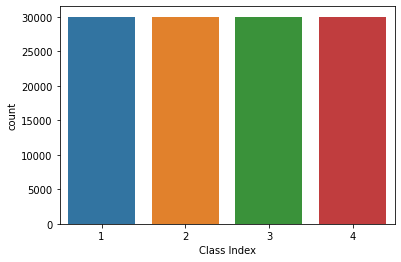

In [23]:
sns.countplot(raw_train_data['Class Index'])

In [39]:
raw_train_data.head()

,Class Index,Title,Description
0,3,Wall St. Bears Claw Back Into the Black (Reuters),"Reuters - Short-sellers, Wall Street's dwindli..."
1,3,Carlyle Looks Toward Commercial Aerospace (Reu...,Reuters - Private investment firm Carlyle Grou...
2,3,Oil and Economy Cloud Stocks' Outlook (Reuters),Reuters - Soaring crude prices plus worries\ab...
3,3,Iraq Halts Oil Exports from Main Southern Pipe...,Reuters - Authorities have halted oil export\f...
4,3,"Oil prices soar to all-time record, posing new...","AFP - Tearaway world oil prices, toppling reco..."


Visualisasi data per topik dengan menggunakan word cloud

In [49]:
world = raw_train_data.Description[raw_train_data['Class Index'][raw_train_data['Class Index']==1].index]

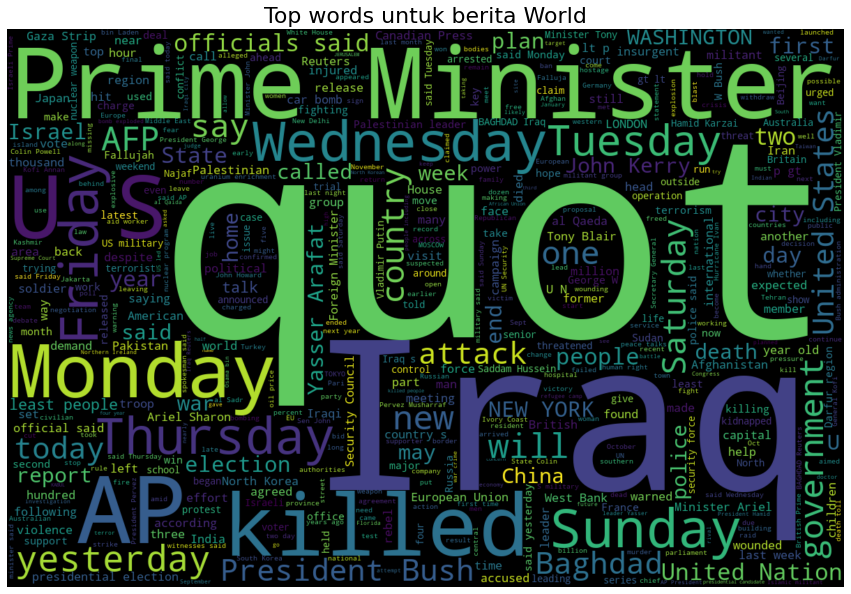

In [66]:
plt.figure(figsize = (15,20)) ;
wordcloud = WordCloud(min_font_size = 3,  max_words = 500 , width = 1200 , height = 800).generate(" ".join(world))
plt.imshow(wordcloud,interpolation = 'bilinear');
plt.title('Top words untuk berita World', fontdict={'size': 22})
plt.axis("off");

In [58]:
sports  = raw_train_data.Description[raw_train_data['Class Index'][raw_train_data['Class Index']==2].index]

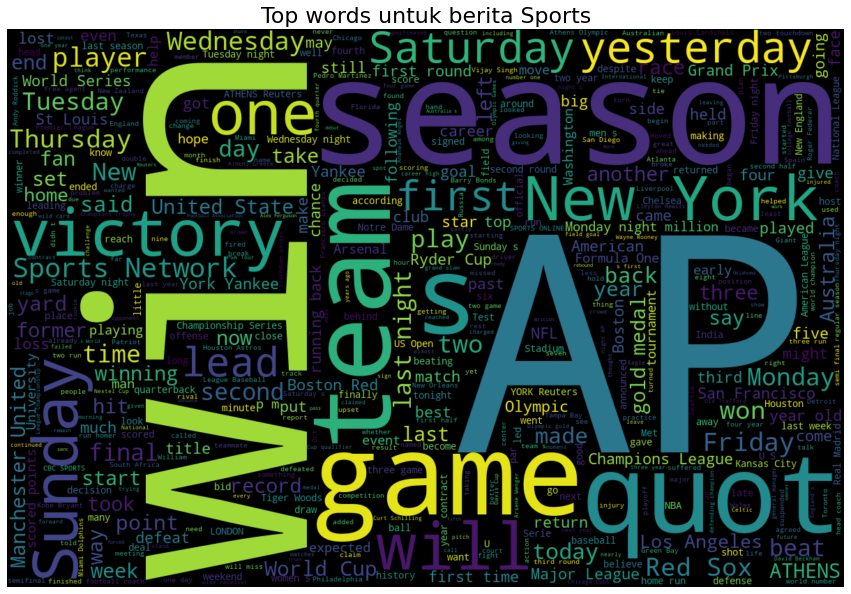

In [65]:
plt.figure(figsize = (15,20)) ;
wordcloud = WordCloud(min_font_size = 3,  max_words = 500 , width = 1200 , height = 800).generate(" ".join(sports))
plt.imshow(wordcloud,interpolation = 'bilinear');
plt.title('Top words untuk berita Sports', fontdict={'size': 22})
plt.axis("off");

In [60]:
business  = raw_train_data.Description[raw_train_data['Class Index'][raw_train_data['Class Index']==3].index]

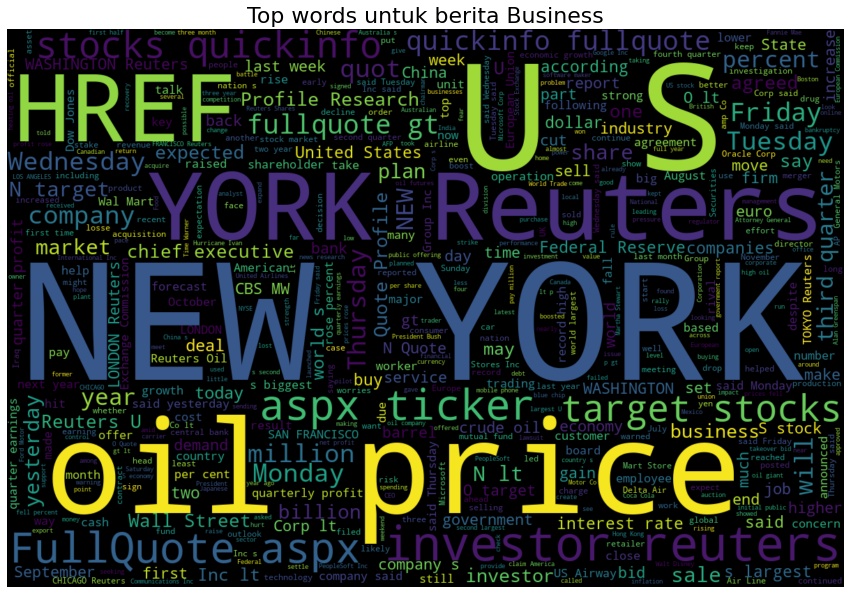

In [62]:
plt.figure(figsize = (15,20)) ;
wordcloud = WordCloud(min_font_size = 3,  max_words = 500 , width = 1200 , height = 800).generate(" ".join(business))
plt.imshow(wordcloud,interpolation = 'bilinear');
plt.title('Top words untuk berita Business', fontdict={'size': 22})
plt.axis("off");

In [63]:
scitech  = raw_train_data.Description[raw_train_data['Class Index'][raw_train_data['Class Index']==4].index]

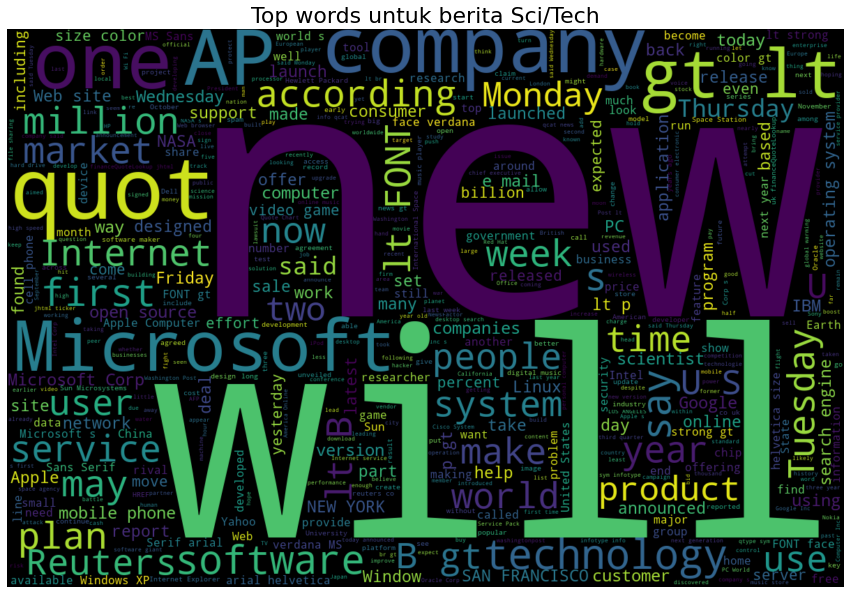

In [64]:
plt.figure(figsize = (15,20)) ;
wordcloud = WordCloud(min_font_size = 3,  max_words = 500 , width = 1200 , height = 800).generate(" ".join(scitech))
plt.imshow(wordcloud,interpolation = 'bilinear');
plt.title('Top words untuk berita Sci/Tech', fontdict={'size': 22})
plt.axis("off");

Dapat dilihat word cloud dari semua topik sehingga kata-kata yang sering muncul pada suatu topik dapat terlihat. Dari visualisasi ini juga tampak adanya beberapa tag-tag html yang belum bersih yang diproses pada tahap selanjutnya.

# Preprocessing dengan Tokenizer

In [6]:
print(stopwords.words('english'))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

Cleaning

Fungsi yang digunakan untuk standarisasi data, yaitu berupa lowercase, menghapus tanda baca, url, dan tag html

In [7]:
def clean_text(text):
    text = str(text).lower()
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('href', '', text)
    text = re.sub('quot', '', text)
    text = re.sub('aspx', '', text)
    text = re.sub('\n', '', text)
    text = re.sub('\w*\d\w*', '', text)
    return text

In [14]:
X_train['text_cleaned'] = X_train['Text'].apply(clean_text)
X_test['text_cleaned'] = X_test['Text'].apply(clean_text)
X_train.head()

,Text,text_cleaned
0,Wall St. Bears Claw Back Into the Black (Reute...,wall st bears claw back into the black reuters...
1,Carlyle Looks Toward Commercial Aerospace (Reu...,carlyle looks toward commercial aerospace reut...
2,Oil and Economy Cloud Stocks' Outlook (Reuters...,oil and economy cloud stocks outlook reuters r...
3,Iraq Halts Oil Exports from Main Southern Pipe...,iraq halts oil exports from main southern pipe...
4,"Oil prices soar to all-time record, posing new...",oil prices soar to alltime record posing new m...


Memastikan semua data telah bersih.

Untuk metode deep learning dengan ukuran vocab yang cukup besar dan data yang cukup banyak penghapusan stopword dan stemming/lemmatization dapat mengurangi performa model. Hal ini terjadi karena informasi dapat hilang akibat dua langkah tersebut.

Stopwords

In [15]:
stop_words = stopwords.words('english')
more_stopwords = ['u', 'im', 'c']
stop_words = stop_words + more_stopwords

def remove_stopwords(text):
    text = ' '.join(word for word in text.split(' ') if word not in stop_words)
    return text

In [16]:
X_train['text_processed'] = X_train['text_cleaned'].apply(remove_stopwords)
X_test['text_processed'] = X_test['text_cleaned'].apply(remove_stopwords)
X_train.head()

,Text,text_cleaned,text_processed
0,Wall St. Bears Claw Back Into the Black (Reute...,wall st bears claw back into the black reuters...,wall st bears claw back black reuters reuters ...
1,Carlyle Looks Toward Commercial Aerospace (Reu...,carlyle looks toward commercial aerospace reut...,carlyle looks toward commercial aerospace reut...
2,Oil and Economy Cloud Stocks' Outlook (Reuters...,oil and economy cloud stocks outlook reuters r...,oil economy cloud stocks outlook reuters reute...
3,Iraq Halts Oil Exports from Main Southern Pipe...,iraq halts oil exports from main southern pipe...,iraq halts oil exports main southern pipeline ...
4,"Oil prices soar to all-time record, posing new...",oil prices soar to alltime record posing new m...,oil prices soar alltime record posing new mena...


Stemming

In [17]:
stemmer = nltk.SnowballStemmer("english")

def stemm_text(text):
    text = ' '.join(stemmer.stem(word) for word in text.split(' '))
    return text

In [18]:
X_train['text_processed'] = X_train['text_processed'].apply(stemm_text)
X_test['text_processed'] = X_test['text_processed'].apply(stemm_text)
X_train.head()

,Text,text_cleaned,text_processed
0,Wall St. Bears Claw Back Into the Black (Reute...,wall st bears claw back into the black reuters...,wall st bear claw back black reuter reuter sh...
1,Carlyle Looks Toward Commercial Aerospace (Reu...,carlyle looks toward commercial aerospace reut...,carlyl look toward commerci aerospac reuter re...
2,Oil and Economy Cloud Stocks' Outlook (Reuters...,oil and economy cloud stocks outlook reuters r...,oil economi cloud stock outlook reuter reuter ...
3,Iraq Halts Oil Exports from Main Southern Pipe...,iraq halts oil exports from main southern pipe...,iraq halt oil export main southern pipelin reu...
4,"Oil prices soar to all-time record, posing new...",oil prices soar to alltime record posing new m...,oil price soar alltim record pose new menac us...


In [19]:
label_map = {1:'Worlds', 2:'Sports', 3:'Business', 4:'Sci/Tech'}
label_map

{1: 'Worlds', 2: 'Sports', 3: 'Business', 4: 'Sci/Tech'}

Split, tokenize, and padding

Dilakukan train-validation split terlebih dahulu sehingga vocabulary yang terbentuk murni dari dataset train saja. Hal ini dilakukan untuk menghindari adanya information leakage pada proses training.

In [20]:
def tfidf_vect(data, testdata, vocab_size):
  #tf-idf
  tfidf=TfidfVectorizer(max_features=vocab_size,min_df=6)
  X_train = tfidf.fit_transform(data)
  X_test = tfidf.transform(testdata)
  word_index = tfidf.get_feature_names()
  print(word_index)

  return X_train, X_test

In [21]:
def vectorize(data, target, X_test, split_size, random_seed, vocab_size, sequence_length):
  #split
  raw_X_train, raw_X_val, y_train, y_val = train_test_split(data, target, test_size=split_size, random_state=random_seed)

  #fit tokenizer
  tok = Tokenizer(num_words=vocab_size, oov_token='[UNK]')
  tok.fit_on_texts(raw_X_train.values)
  word_index = tok.word_index
  print(word_index)

  #tokenize data
  X_train = tok.texts_to_sequences(raw_X_train)
  X_val = tok.texts_to_sequences(raw_X_val)
  X_test = tok.texts_to_sequences(X_test)

  #pad data
  X_train = pad_sequences(X_train, maxlen=sequence_length, padding='post')
  X_val = pad_sequences(X_val, maxlen=sequence_length, padding='post')
  X_test = pad_sequences(X_test, maxlen=sequence_length, padding='post')

  return X_train, X_val, X_test, y_train, y_val


Di sini dilakukan 2 jenis preprocessing, data cleaning saja dan data cleaning + stopwords removal + stemming agar dapat dibandingkan performa keduanya. Tampak vocabulary yang berbeda dari kedua proses tersebut

In [22]:
cleaned_data = X_train['text_cleaned']
processed_data = X_train['text_processed']
test_cleaned_data = X_test['text_cleaned']
test_processed_data = X_test['text_processed']

y_train = raw_train_data['Class Index']
y_test = test_data['Class Index']

In [23]:
X_processed, X_test_processed = tfidf_vect(processed_data, test_processed_data, VOCAB_SIZE)
X_cleaned, X_test_cleaned = tfidf_vect(cleaned_data, test_cleaned_data, VOCAB_SIZE)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


['aapl', 'aaron', 'ab', 'ababa', 'abandon', 'abba', 'abbey', 'abbott', 'abc', 'abdic', 'abduct', 'abductor', 'abdul', 'abdullah', 'abid', 'abidjan', 'abil', 'abl', 'ablaz', 'abn', 'aboard', 'aborigin', 'abort', 'abound', 'abramovich', 'abroad', 'abrupt', 'absa', 'absenc', 'absent', 'absente', 'absolut', 'absorb', 'abu', 'abuja', 'abund', 'abus', 'abuzz', 'ac', 'academ', 'academi', 'acc', 'acceler', 'accept', 'access', 'accessori', 'accid', 'accident', 'acclaim', 'accommod', 'accompani', 'accomplish', 'accord', 'account', 'accumul', 'accur', 'accuraci', 'accus', 'accustom', 'ace', 'aceh', 'acer', 'ach', 'achiev', 'achill', 'acid', 'acknowledg', 'acquir', 'acquisit', 'acquit', 'acquitt', 'acr', 'acrobat', 'across', 'act', 'action', 'activ', 'activis', 'activist', 'actor', 'actress', 'actual', 'acut', 'ad', 'adam', 'adapt', 'adb', 'add', 'addi', 'addict', 'addit', 'addon', 'address', 'adelaid', 'adelphia', 'adequ', 'adjourn', 'adjust', 'administr', 'admir', 'admiss', 'admit', 'adob', 'ado

In [ ]:
#deep learning preprocess
#X_cleaned, X_val_cleaned, X_test_cleaned, y_train, y_val = vectorize(cleaned_data, y_train, test_cleaned_data, VALIDATION_SPLIT, SEED, VOCAB_SIZE, SEQUENCE_LENGTH)


{'[UNK]': 1, 'the': 2, 'to': 3, 'a': 4, 'of': 5, 'in': 6, 'and': 7, 'on': 8, 'for': 9, '39s': 10, 'that': 11, 'with': 12, 'as': 13, 'at': 14, 'its': 15, 'is': 16, 'new': 17, 'by': 18, 'said': 19, 'us': 20, 'it': 21, 'has': 22, 'from': 23, 'reuters': 24, 'an': 25, 'ap': 26, 'his': 27, 'will': 28, 'after': 29, 'was': 30, 'be': 31, 'have': 32, 'over': 33, 'their': 34, 'up': 35, 'are': 36, 'but': 37, 'more': 38, 'first': 39, 'two': 40, 'he': 41, 'this': 42, 'world': 43, 'monday': 44, 'wednesday': 45, 'tuesday': 46, 'thursday': 47, 'oil': 48, 'company': 49, 'out': 50, 'one': 51, 'not': 52, 'against': 53, 'friday': 54, 'into': 55, 'inc': 56, 'about': 57, 'last': 58, 'than': 59, 'they': 60, 'york': 61, '39': 62, 'yesterday': 63, 'year': 64, 'iraq': 65, 'who': 66, 'were': 67, 'president': 68, 'no': 69, 'microsoft': 70, 'million': 71, 'been': 72, 'says': 73, 'had': 74, 'united': 75, 'week': 76, 'game': 77, 'when': 78, 'years': 79, 'corp': 80, 'prices': 81, 'three': 82, 'could': 83, 'would': 84,

# Model 1: Multinomial Naive Bayes

Model pertama yang digunakan sebagai baseline adalah Naive Bayes dengan parameter default. Pertama dengan data yang melalui proses data cleaning saja.

In [24]:
model_mnnaivebayes=MultinomialNB()
model_mnnaivebayes.fit(X_cleaned, y_train)


MultinomialNB()

In [25]:
y_preds = model_mnnaivebayes.predict(X_test_cleaned)

In [26]:
print(classification_report(y_test, y_preds, digits=3))

              precision    recall  f1-score   support

           1      0.913     0.889     0.901      1900
           2      0.941     0.977     0.959      1900
           3      0.864     0.844     0.854      1900
           4      0.862     0.871     0.866      1900

    accuracy                          0.895      7600
   macro avg      0.895     0.895     0.895      7600
weighted avg      0.895     0.895     0.895      7600



AxesSubplot(0.125,0.125;0.62x0.755)


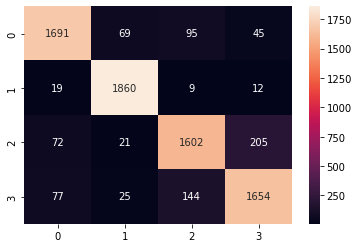

In [61]:
print(sns.heatmap(confusion_matrix(y_test, y_preds),annot=True,fmt="d"))

Model Naive Bayes selanjutnya menggunakan prapemrosesan data tambahan berupa stop words removal dan stemming.

In [27]:
model_mnnaivebayes_proc=MultinomialNB()
model_mnnaivebayes_proc.fit(X_processed, y_train)

MultinomialNB()

In [28]:
y_proc_preds = model_mnnaivebayes_proc.predict(X_test_processed)

In [29]:
print(classification_report(y_test, y_proc_preds, digits=3))

              precision    recall  f1-score   support

           1      0.911     0.889     0.900      1900
           2      0.949     0.977     0.963      1900
           3      0.863     0.849     0.856      1900
           4      0.867     0.876     0.871      1900

    accuracy                          0.898      7600
   macro avg      0.897     0.898     0.897      7600
weighted avg      0.897     0.898     0.897      7600



AxesSubplot(0.125,0.125;0.62x0.755)


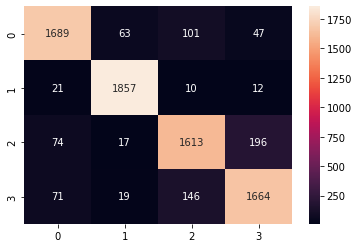

In [30]:
print(sns.heatmap(confusion_matrix(y_test, y_proc_preds),annot=True,fmt="d"))

Dapat dilihat model Naive Bayes yang menggunakan proses stop words removal dan stemming memiliki performa yang sedikit lebih baik, yaitu dari 0.895 ke 0.897

# Model 2: Stochastic Gradient Descent

Model kedua yang digunakan sebagai baseline adalah SGD Classifier dengan parameter default, parameter default ini berupa classifier SVM. Pertama juga dengan data yang melalui proses data cleaning saja.

In [63]:
model_SGD=SGDClassifier()
model_SGD.fit(X_cleaned, y_train)

SGDClassifier()

In [76]:
y_preds = model_SGD.predict(X_test_cleaned)

In [65]:
print(classification_report(y_test, y_preds, digits=3))

              precision    recall  f1-score   support

           1      0.925     0.893     0.908      1900
           2      0.936     0.986     0.960      1900
           3      0.877     0.862     0.869      1900
           4      0.882     0.881     0.881      1900

    accuracy                          0.905      7600
   macro avg      0.905     0.905     0.905      7600
weighted avg      0.905     0.905     0.905      7600



AxesSubplot(0.125,0.125;0.62x0.755)


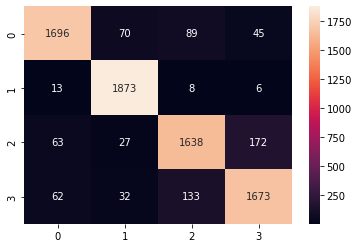

In [66]:
print(sns.heatmap(confusion_matrix(y_test, y_preds),annot=True,fmt="d"))

Model SVM selanjutnya menggunakan prapemrosesan data tambahan berupa stop words removal dan stemming.

In [31]:
model_SGD_proc=SGDClassifier()
model_SGD_proc.fit(X_processed, y_train)

SGDClassifier()

In [32]:
y_proc_preds = model_SGD_proc.predict(X_test_processed)

In [33]:
print(classification_report(y_test, y_proc_preds, digits=3))

              precision    recall  f1-score   support

           1      0.927     0.894     0.910      1900
           2      0.941     0.983     0.962      1900
           3      0.877     0.868     0.872      1900
           4      0.885     0.886     0.885      1900

    accuracy                          0.908      7600
   macro avg      0.907     0.908     0.907      7600
weighted avg      0.907     0.908     0.907      7600



AxesSubplot(0.125,0.125;0.62x0.755)


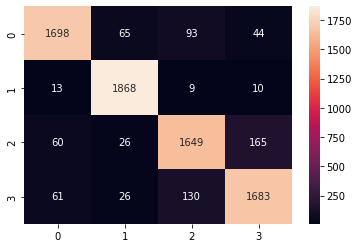

In [34]:
print(sns.heatmap(confusion_matrix(y_test, y_proc_preds),annot=True,fmt="d"))

Seperti pada model sebelumnya, model SVM yang menggunakan proses stop words removal dan stemming juga memiliki performa yang sedikit lebih baik, yaitu dari 0.905 ke 0.907

# Model 3: XGBoost

Model ketiga menggunakan XGBoost dengan parameter default.

In [35]:
model_xgb=xgb.XGBClassifier()
model_xgb.fit(X_cleaned, y_train)

XGBClassifier(objective='multi:softprob')

In [36]:
y_preds = model_xgb.predict(X_test_cleaned)

In [37]:
print(classification_report(y_test, y_preds, digits=3))

              precision    recall  f1-score   support

           1      0.881     0.747     0.808      1900
           2      0.818     0.896     0.855      1900
           3      0.780     0.761     0.770      1900
           4      0.716     0.775     0.745      1900

    accuracy                          0.795      7600
   macro avg      0.799     0.795     0.795      7600
weighted avg      0.799     0.795     0.795      7600



AxesSubplot(0.125,0.125;0.62x0.755)


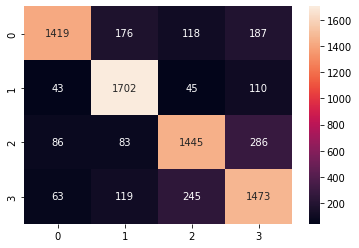

In [38]:
print(sns.heatmap(confusion_matrix(y_test, y_preds),annot=True,fmt="d"))

Hasil algoritma XGBoost dengan parameter default mendapatkan hasil F1-score sebesar 0.795. Dapat dilihat algoritma ini memiliki hasil yang relatif lebih buruk daripada algoritma Naive Bayes dan SVM. Hal ini kemungkinan terjadi karena parameter default pada XGBoost tidak memiliki performa yang optimal untuk dataset yang besar, sehingga kompleksitas dari algoritma ini ditingkatkan dengan memperbesar total boosting (n_estimators) dari default 100 ke 200 dan jumlah kedalaman dari tiap tree (max_depth) dari default 6 ke 15

In [39]:
model_xgb=xgb.XGBClassifier(n_estimators=200, max_depth=15)
model_xgb.fit(X_cleaned, y_train)

XGBClassifier(max_depth=15, n_estimators=200, objective='multi:softprob')

In [40]:
y_preds = model_xgb.predict(X_test_cleaned)

In [41]:
print(classification_report(y_test, y_preds, digits=3))

              precision    recall  f1-score   support

           1      0.923     0.888     0.905      1900
           2      0.928     0.962     0.945      1900
           3      0.871     0.853     0.862      1900
           4      0.855     0.874     0.865      1900

    accuracy                          0.894      7600
   macro avg      0.894     0.894     0.894      7600
weighted avg      0.894     0.894     0.894      7600



AxesSubplot(0.125,0.125;0.62x0.755)


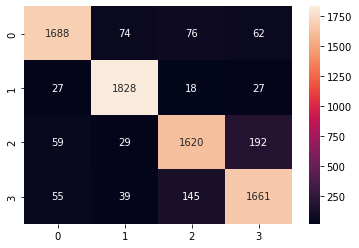

In [42]:
print(sns.heatmap(confusion_matrix(y_test, y_preds),annot=True,fmt="d"))

Dapat dilihat performa XGBoost yang memiliki kompleksitas lebih tinggi memiliki performa yang lebih baik, yaitu F1-score meningkat dari 0.795 ke 0.894. Algoritma XGBoost dapat ditingkatkan lagi menggunakan tuner seperti hyperopt karena jumlah parameter yang dapat di-tune sangat banyak untuk grid search maupun random search.

# Model 4: Baseline LSTM


Model selanjutnya adalah algoritma deep learning. Pertama model LSTM dasar dengan nilai dropout kecil. Pada setiap model juga menggunakan zero mask agar dalam proses pelatihan dapat memproses padding 0 lebih cepat.

Preprocessing untuk algoritma deep learning

In [ ]:
X_cleaned, X_val_cleaned, X_test_cleaned, y_train, y_val = vectorize(cleaned_data, y_train, test_cleaned_data, VALIDATION_SPLIT, SEED, VOCAB_SIZE, SEQUENCE_LENGTH)


{'[UNK]': 1, 'the': 2, 'to': 3, 'a': 4, 'of': 5, 'in': 6, 'and': 7, 'on': 8, 'for': 9, '39s': 10, 'that': 11, 'with': 12, 'as': 13, 'at': 14, 'its': 15, 'is': 16, 'new': 17, 'by': 18, 'said': 19, 'us': 20, 'it': 21, 'has': 22, 'from': 23, 'reuters': 24, 'an': 25, 'ap': 26, 'his': 27, 'will': 28, 'after': 29, 'was': 30, 'be': 31, 'have': 32, 'over': 33, 'their': 34, 'up': 35, 'are': 36, 'but': 37, 'more': 38, 'first': 39, 'two': 40, 'he': 41, 'this': 42, 'world': 43, 'monday': 44, 'wednesday': 45, 'tuesday': 46, 'thursday': 47, 'oil': 48, 'company': 49, 'out': 50, 'one': 51, 'not': 52, 'against': 53, 'friday': 54, 'into': 55, 'inc': 56, 'about': 57, 'last': 58, 'than': 59, 'they': 60, 'york': 61, '39': 62, 'yesterday': 63, 'year': 64, 'iraq': 65, 'who': 66, 'were': 67, 'president': 68, 'no': 69, 'microsoft': 70, 'million': 71, 'been': 72, 'says': 73, 'had': 74, 'united': 75, 'week': 76, 'game': 77, 'when': 78, 'years': 79, 'corp': 80, 'prices': 81, 'three': 82, 'could': 83, 'would': 84,

In [38]:
callback_list = [
                 tf.keras.callbacks.EarlyStopping(
                     monitor='val_accuracy', 
                     patience=4,
                     verbose=1
                     ),
                 tf.keras.callbacks.ModelCheckpoint(
                     monitor='val_accuracy',
                     filepath="/logs/checkpoint/best_baseline_model_a_.hdf5", 
                     save_best_only=True,
                     verbose=1
                     ),
                 tf.keras.callbacks.ReduceLROnPlateau(
                     #monitor=val_accuracy,
                     patience=3, 
                     min_lr=0.00001,
                     verbose=1
                     ), 
                 tf.keras.callbacks.TensorBoard(
                     log_dir="/logs/tensorboard"
                 )
                 ]

In [39]:
model_lstm_baseline = tf.keras.Sequential([
    #vectorize_layer,
    tf.keras.layers.Embedding(VOCAB_SIZE, EMBED_SIZE, input_length=SEQUENCE_LENGTH, mask_zero=True),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.LSTM(64),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(6, activation='softmax')
])

In [40]:
model_lstm_baseline.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 500, 128)          1280000   
                                                                 
 dropout (Dropout)           (None, 500, 128)          0         
                                                                 
 lstm (LSTM)                 (None, 64)                49408     
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                                 
 dense (Dense)               (None, 64)                4160      
                                                                 
 dense_1 (Dense)             (None, 6)                 390       
                                                                 
Total params: 1,333,958
Trainable params: 1,333,958
Non-

In [41]:
model_lstm_baseline.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    metrics=['accuracy']
)

In [42]:
history_baseline_cleaned = model_lstm_baseline.fit(
    X_cleaned,
    y_train,
    batch_size=BATCH_SIZE,
    validation_data=(X_val_cleaned, y_val),
    epochs=EPOCH,
    callbacks=[callback_list] 
)

Epoch 1/10
2999/3000 [============================>.] - ETA: 0s - loss: 0.3907 - accuracy: 0.8614
Epoch 1: val_accuracy improved from -inf to 0.90904, saving model to /logs/checkpoint/best_baseline_model_a_.hdf5
3000/3000 [==============================] - 42s 12ms/step - loss: 0.3907 - accuracy: 0.8614 - val_loss: 0.2791 - val_accuracy: 0.9090 - lr: 0.0010
Epoch 2/10
2999/3000 [============================>.] - ETA: 0s - loss: 0.2376 - accuracy: 0.9235
Epoch 2: val_accuracy improved from 0.90904 to 0.91229, saving model to /logs/checkpoint/best_baseline_model_a_.hdf5
3000/3000 [==============================] - 33s 11ms/step - loss: 0.2376 - accuracy: 0.9235 - val_loss: 0.2663 - val_accuracy: 0.9123 - lr: 0.0010
Epoch 3/10
2997/3000 [============================>.] - ETA: 0s - loss: 0.1920 - accuracy: 0.9359
Epoch 3: val_accuracy did not improve from 0.91229
3000/3000 [==============================] - 33s 11ms/step - loss: 0.1920 - accuracy: 0.9359 - val_loss: 0.2735 - val_accuracy: 

In [43]:
%load_ext tensorboard

In [44]:
%tensorboard --logdir /logs/tensorboard

<IPython.core.display.Javascript object>

In [48]:
y_preds = [np.argmax(i) for i in model_lstm_baseline.predict(X_test_cleaned)]

238/238 [==============================] - 1s 4ms/step


In [49]:
print(classification_report(y_test, y_preds, digits=3))

              precision    recall  f1-score   support

           1      0.915     0.901     0.908      1900
           2      0.960     0.965     0.962      1900
           3      0.876     0.872     0.874      1900
           4      0.874     0.887     0.880      1900

    accuracy                          0.906      7600
   macro avg      0.906     0.906     0.906      7600
weighted avg      0.906     0.906     0.906      7600



AxesSubplot(0.125,0.125;0.62x0.755)


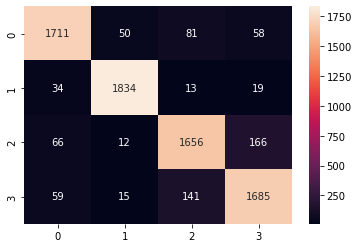

In [50]:
print(sns.heatmap(confusion_matrix(y_test, y_preds),annot=True,fmt="d"))

Didapat F1-score untuk arsitektur baseline sebesar 0.906.

# Model 5: Stacked Bidirectional LSTM + GRU 

Layer Bidirectional LSTM memproses sekuens data dalam kedua arah, hal ini mirip dengan makna dari kalimat yang sama walaupun urutan kata berubah.

In [51]:
callback_list = [
                 tf.keras.callbacks.EarlyStopping(
                     monitor='val_accuracy', 
                     patience=4,
                     verbose=1
                     ),
                 tf.keras.callbacks.ModelCheckpoint(
                     monitor='val_accuracy',
                     filepath="/logs/checkpoint/best_bilstm_gru_model.hdf5", 
                     save_best_only=True,
                     verbose=1
                     ),
                 tf.keras.callbacks.ReduceLROnPlateau(
                     #monitor=val_accuracy,
                     patience=3, 
                     min_lr=0.00001,
                     verbose=1
                     ), 
                 tf.keras.callbacks.TensorBoard(
                     log_dir="/logs/tensorboard"
                 )
                 ]

In [52]:
model_bilstm_gru = tf.keras.Sequential([
    #vectorize_layer,
    tf.keras.layers.Embedding(VOCAB_SIZE, EMBED_SIZE, input_length=SEQUENCE_LENGTH, mask_zero=True),
    tf.keras.layers.SpatialDropout1D(0.5),
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, return_sequences=True)),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Bidirectional(tf.keras.layers.GRU(64, return_sequences=True)),
    tf.keras.layers.GlobalMaxPool1D(),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(6, activation='softmax')
])

In [53]:
model_bilstm_gru.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 500, 128)          1280000   
                                                                 
 spatial_dropout1d (SpatialD  (None, 500, 128)         0         
 ropout1D)                                                       
                                                                 
 bidirectional (Bidirectiona  (None, 500, 256)         263168    
 l)                                                              
                                                                 
 dropout_2 (Dropout)         (None, 500, 256)          0         
                                                                 
 bidirectional_1 (Bidirectio  (None, 500, 128)         123648    
 nal)                                                            
                                                      

In [54]:
model_bilstm_gru.compile(
    loss='sparse_categorical_crossentropy',
    optimizer='adam',
    metrics=['accuracy']
)

In [55]:
history_bilstm_gru = model_bilstm_gru.fit(
    X_cleaned,
    y_train,
    batch_size=BATCH_SIZE,
    validation_data=(X_val_cleaned, y_val),
    epochs=EPOCH,
    callbacks=[callback_list] 
)

Epoch 1/10
3000/3000 [==============================] - ETA: 0s - loss: 0.4130 - accuracy: 0.8602
Epoch 1: val_accuracy improved from -inf to 0.91167, saving model to /logs/checkpoint/best_bilstm_gru_model.hdf5
3000/3000 [==============================] - 110s 33ms/step - loss: 0.4130 - accuracy: 0.8602 - val_loss: 0.2627 - val_accuracy: 0.9117 - lr: 0.0010
Epoch 2/10
3000/3000 [==============================] - ETA: 0s - loss: 0.2629 - accuracy: 0.9176
Epoch 2: val_accuracy improved from 0.91167 to 0.91408, saving model to /logs/checkpoint/best_bilstm_gru_model.hdf5
3000/3000 [==============================] - 92s 31ms/step - loss: 0.2629 - accuracy: 0.9176 - val_loss: 0.2667 - val_accuracy: 0.9141 - lr: 0.0010
Epoch 3/10
2999/3000 [============================>.] - ETA: 0s - loss: 0.2324 - accuracy: 0.9269
Epoch 3: val_accuracy did not improve from 0.91408
3000/3000 [==============================] - 94s 31ms/step - loss: 0.2324 - accuracy: 0.9269 - val_loss: 0.2552 - val_accuracy: 0

In [56]:
%tensorboard --logdir /logs/tensorboard

Reusing TensorBoard on port 6006 (pid 296), started 0:14:20 ago. (Use '!kill 296' to kill it.)

<IPython.core.display.Javascript object>

In [57]:
y_preds = [np.argmax(i) for i in model_bilstm_gru.predict(X_test_cleaned)]

238/238 [==============================] - 7s 11ms/step


In [59]:
print(classification_report(y_test, y_preds, digits=3))

              precision    recall  f1-score   support

           1      0.933     0.903     0.918      1900
           2      0.953     0.984     0.968      1900
           3      0.884     0.879     0.882      1900
           4      0.890     0.893     0.892      1900

    accuracy                          0.915      7600
   macro avg      0.915     0.915     0.915      7600
weighted avg      0.915     0.915     0.915      7600



AxesSubplot(0.125,0.125;0.62x0.755)


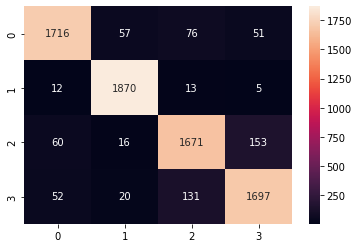

In [60]:
print(sns.heatmap(confusion_matrix(y_test, y_preds),annot=True,fmt="d"))

Didapat F1-score untuk arsitektur kedua sebesar 0.915      

# Kesimpulan

Hasil F1-score untuk kelima model tersebut yaitu:

*   Naive Bayes: 0.896
*   SGD Classifier (SVM): 0.905 
*   XGBoost: 0.796
*   XGBoost (tuned): 0.896
*   LSTM: 0.906
*   LSTM-GRU: 0.915

Dengan menggunakan parameter default, algoritma Naive Bayes dan SGD Classifier mencapai hasil yang cukup memuaskan, yaitu F1-score sebesar 89.8% dan 90.7%. Sedangkan untuk parameter default algoritma XGBoost hanya didapat 79.6%, namun setelah search space diperluas dengan menambah jumlah estimator dan kedalaman maksimal dari tree didapat performa meningkat mencapai F1-score sebesar 89.6%. Performa XGBoost dapat dituning lebih baik, namun total waktu pelatihan akan melampaui pelatihan algoritma deep learning apabila hanya menggunakan grid search maupun random search sebagai algoritma tuner. 
Hasil terbaik yang dapat digunakan untuk mengklasifikasikan berita didapat oleh model deep learning dengan arsitektur LSTM-GRU yang mencapai F1-score sebesar 91.5%.